# Fetal Health Classification

The purpose of this code notebook is to clean and prepare the fetal health classification data into a useable format to predict fetal health outcomes accurately using Cardiotocograms (CTGs) data to prevent or decrease child and maternal mortality.

A decrease in the child mortality rate is one of the United Nations’ Sustainable Development Goals. Parallel to the notion of child mortality is of course maternal mortality, which accounts for 295 000 deaths during and following pregnancy and childbirth (as of 2017). The vast majority of these deaths (94%) occurred in low-resource settings, and most could have been prevented.

Cardiotocograms (CTGs) can be used as a simple and cost-effective method for assessing fetal health and taking action to prevent child and maternal mortality. CTGs work by sending ultrasound pulses and reading their response to gather information about the fetal heart rate (FHR), fetal movements, uterine contractions, and other factors.

Cardiotocogram (CTG) is the most widely used in the clinical routine evaluation to detect fetal state and has enabled clinical practitioners to detect signs of fetal compromise at an early stage. It provides information on uterine respiration and fetal heart rate, which can be used to determine whether the fetus is healthy, suspect, or pathological.

Having a predictive model would be a valuable tool for the healthcare industry. This healthcare facility wants to make an impact by being able to predict fetal health outcomes which would in the end prevent or decrease child and maternal mortality.  


### Dataset:

The dataset is from Kaggle and contains 2,126 rows of 22 features extracted from Cardiotocogram (CTG) exams, which were then classified by three expert obstetricians into 3 classes: Normal, Suspect, and Pathological.

The data description is detailed below:

- baseline_value: Baseline Fetal Heart Rate (FHR)
- accelerations: Number of accelerations per second
- fetal_movement: Number of fetal movements per second
- uterine_contractions: Number of uterine contractions per second
- light_decelerations: Number of LDs per second
- severe_decelerations: Number of SDs per second
- prolongued_decelerations: Number of PDs per second
- abnormal_short_term_variability: Percentage of time with abnormal short term variability
- mean_value_of_short_term_variability: Mean value of short term variability
- percentage_of_time_with_abnormal_long_term_variability: Percentage of time with abnormal long term variability
- mean_value_of_long_term_variability: Mean value of long term variability
- histogram_width: Width of the histogram made using all values from a record
- histogram_min: Histogram minimum value
- histogram_max: Histogram maximum value
- histogram_number_of_peaks: Number of peaks in the exam histogram
- histogram_number_of_zeroes: Number of zeroes in the exam histogram
- histogram_mode: Histogram mode
- histogram_mean: Histogram mean
- histogram_median: Histogram median
- histogram_variance: Histogram variance
- histogram_tendency: Histogram trend
- fetal_health: Fetal health:
   - 1 - Normal
   - 2 - Suspect
   - 3 - Pathological

### Citation:
Ayres de Campos et al. (2000) SisPorto 2.0 A Program for Automated Analysis of Cardiotocograms. J Matern Fetal Med 5:311-318 (Link9:5%3C311::AID-MFM12%3E3.0.CO;2-9))


## PART ONE

## Data Wrangling

### Data Collection:
__Goal:__ Organize the data to streamline the next steps of the capstone project.<br>
__Performed:__ Data loading

### Data Organization:
__Goal:__ Create the file structure and add the work project to the GitHub repository created for this project.<br>
__Performed:__ A file structure was created in GitHub for repository for this capstone project and glob library also downloaded for the project.

### Data Definition:
__Goal:__ Gain an understanding of the data features to inform the next steps of the project.<br>
__Performed:__ Check the column names, data types, described the columns, counts, percents of unique values, ranges of the values.
    
### Data Cleaning:
__Goal:__ Clean up the data in order to prepare it for the next steps of the project.<br>
__Performed:__ Checking for missing values, NaN values, duplicates, using appply(), nunique(), .isnull().values.any()

In [1]:
# Imports
import os
import pandas as pd
import numpy as np
import glob
import random
random.seed(1)
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import spearmanr
from sklearn.preprocessing import OneHotEncoder
import ydata_profiling
#!pip install termcolor
#from termcolor import colored
#!pip install colorama
from colorama import Fore, Back, Style
import statsmodels.stats.weightstats as ws
import scipy.stats as stats
import statsmodels.api as sm
from statsmodels.formula.api import ols
from IPython.display import display

This is the best place to put all the libraries needed for the project.

In [2]:
#read in the dataset ('archive/fetal_health.csv')
fhc_dataset = pd.read_csv('archive/fetal_health.csv')

In [3]:
#check the head of the transformed dataframe; check to see the top 5 of the dataset
fhc_dataset.head().T

,0,1,2,3,4
baseline value,120.0,132.000,133.000,134.000,132.000
accelerations,0.0,0.006,0.003,0.003,0.007
fetal_movement,0.0,0.000,0.000,0.000,0.000
uterine_contractions,0.0,0.006,0.008,0.008,0.008
light_decelerations,0.0,0.003,0.003,0.003,0.000
severe_decelerations,0.0,0.000,0.000,0.000,0.000
prolongued_decelerations,0.0,0.000,0.000,0.000,0.000
abnormal_short_term_variability,73.0,17.000,16.000,16.000,16.000
mean_value_of_short_term_variability,0.5,2.100,2.100,2.400,2.400
percentage_of_time_with_abnormal_long_term_variability,43.0,0.000,0.000,0.000,0.000


In [4]:
#find out the shape of the data to determine the number of rows and columns
fhc_dataset.shape

(2126, 22)

This gives a better picture of the number of rows and columns of the dataset.

In [5]:
#print out the columns of the dataset
fhc_dataset.columns

Index(['baseline value', 'accelerations', 'fetal_movement',
       'uterine_contractions', 'light_decelerations', 'severe_decelerations',
       'prolongued_decelerations', 'abnormal_short_term_variability',
       'mean_value_of_short_term_variability',
       'percentage_of_time_with_abnormal_long_term_variability',
       'mean_value_of_long_term_variability', 'histogram_width',
       'histogram_min', 'histogram_max', 'histogram_number_of_peaks',
       'histogram_number_of_zeroes', 'histogram_mode', 'histogram_mean',
       'histogram_median', 'histogram_variance', 'histogram_tendency',
       'fetal_health'],
      dtype='object')

This concisely showed the names of the columns in the dataset and easy indexing if needed.

In [6]:
##call the  info method on fhc_dataset to see a summary of the data and the datatypes present
fhc_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

This gives a summary of the info in the dataset. It shows that the dtype are all float64 but may need to be investigated further.

In [7]:
#calling the describe method gives you a descriptive statistics summary of the data;
#easier to view since less columns for the stats data thereby called in transpose method
fhc_dataset.describe().T

,count,mean,std,min,25%,50%,75%,max
baseline value,2126.0,133.303857,9.840844,106.0,126.000,133.000,140.000,160.000
accelerations,2126.0,0.003178,0.003866,0.0,0.000,0.002,0.006,0.019
fetal_movement,2126.0,0.009481,0.046666,0.0,0.000,0.000,0.003,0.481
uterine_contractions,2126.0,0.004366,0.002946,0.0,0.002,0.004,0.007,0.015
light_decelerations,2126.0,0.001889,0.002960,0.0,0.000,0.000,0.003,0.015
severe_decelerations,2126.0,0.000003,0.000057,0.0,0.000,0.000,0.000,0.001
prolongued_decelerations,2126.0,0.000159,0.000590,0.0,0.000,0.000,0.000,0.005
abnormal_short_term_variability,2126.0,46.990122,17.192814,12.0,32.000,49.000,61.000,87.000
mean_value_of_short_term_variability,2126.0,1.332785,0.883241,0.2,0.700,1.200,1.700,7.000
percentage_of_time_with_abnormal_long_term_variability,2126.0,9.846660,18.396880,0.0,0.000,0.000,11.000,91.000


In [8]:
#find out what dtypes the data has by calling .dtypes
fhc_dataset.dtypes

baseline value                                            float64
accelerations                                             float64
fetal_movement                                            float64
uterine_contractions                                      float64
light_decelerations                                       float64
severe_decelerations                                      float64
prolongued_decelerations                                  float64
abnormal_short_term_variability                           float64
mean_value_of_short_term_variability                      float64
percentage_of_time_with_abnormal_long_term_variability    float64
mean_value_of_long_term_variability                       float64
histogram_width                                           float64
histogram_min                                             float64
histogram_max                                             float64
histogram_number_of_peaks                                 float64
histogram_

In [9]:
#call in the .nunique()method to return the number of unique values for each column of the dataset
fhc_dataset.nunique()

baseline value                                             48
accelerations                                              20
fetal_movement                                            102
uterine_contractions                                       16
light_decelerations                                        16
severe_decelerations                                        2
prolongued_decelerations                                    6
abnormal_short_term_variability                            75
mean_value_of_short_term_variability                       57
percentage_of_time_with_abnormal_long_term_variability     87
mean_value_of_long_term_variability                       249
histogram_width                                           154
histogram_min                                             109
histogram_max                                              86
histogram_number_of_peaks                                  18
histogram_number_of_zeroes                                  9
histogra

Shows that number of unique values in each column.

In [10]:
fhc_dataset.isnull().values.any()

False

Shows there are no missing values in the dataset.

In [11]:
fhc_dataset.isnull().any()

baseline value                                            False
accelerations                                             False
fetal_movement                                            False
uterine_contractions                                      False
light_decelerations                                       False
severe_decelerations                                      False
prolongued_decelerations                                  False
abnormal_short_term_variability                           False
mean_value_of_short_term_variability                      False
percentage_of_time_with_abnormal_long_term_variability    False
mean_value_of_long_term_variability                       False
histogram_width                                           False
histogram_min                                             False
histogram_max                                             False
histogram_number_of_peaks                                 False
histogram_number_of_zeroes              

In [12]:
#find out the number of missing values using .isnull() in each of the column
#find out the percentages using mean 
#present a table with column names of count and percentages
missing =pd.concat([fhc_dataset.isnull().sum(), 100* fhc_dataset.isnull().mean()], axis=1)
missing.columns=['count','%']
missing.sort_values(by=['count', '%'])

,count,%
baseline value,0,0.0
accelerations,0,0.0
fetal_movement,0,0.0
uterine_contractions,0,0.0
light_decelerations,0,0.0
severe_decelerations,0,0.0
prolongued_decelerations,0,0.0
abnormal_short_term_variability,0,0.0
mean_value_of_short_term_variability,0,0.0
percentage_of_time_with_abnormal_long_term_variability,0,0.0


This is another way to confirm that there are no missing data in any of the columns.

In [13]:
#find out if there are duplicates in the dataset
fhc_dataset.duplicated()

0       False
1       False
2       False
3       False
4       False
        ...  
2121    False
2122    False
2123    False
2124    False
2125    False
Length: 2126, dtype: bool

No duplicates found in the dataset

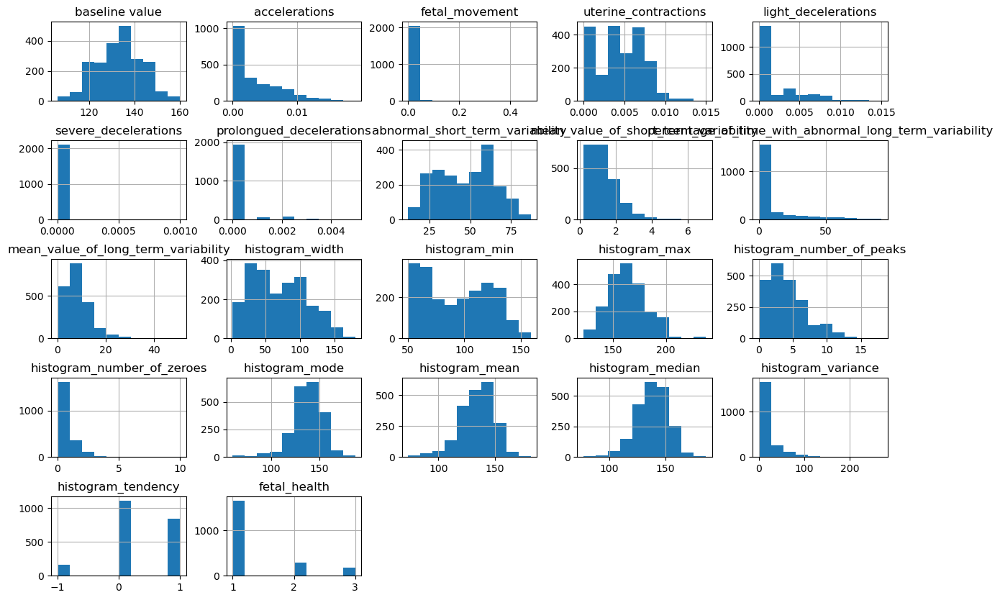

In [14]:
fhc_dataset.hist(figsize=(15,10))
plt.subplots_adjust(hspace=0.5);

Above is a quick overview of the distribution of each of the features of the data.

In [15]:
fhc_dataset.mean()

baseline value                                            133.303857
accelerations                                               0.003178
fetal_movement                                              0.009481
uterine_contractions                                        0.004366
light_decelerations                                         0.001889
severe_decelerations                                        0.000003
prolongued_decelerations                                    0.000159
abnormal_short_term_variability                            46.990122
mean_value_of_short_term_variability                        1.332785
percentage_of_time_with_abnormal_long_term_variability      9.846660
mean_value_of_long_term_variability                         8.187629
histogram_width                                            70.445908
histogram_min                                              93.579492
histogram_max                                             164.025400
histogram_number_of_peaks         

The mean does not give much insight at this time. The differences in the order of magnitude of the values causes us to consider scaling the values before modeling.

In [16]:
fhc_dataset.median()

baseline value                                            133.000
accelerations                                               0.002
fetal_movement                                              0.000
uterine_contractions                                        0.004
light_decelerations                                         0.000
severe_decelerations                                        0.000
prolongued_decelerations                                    0.000
abnormal_short_term_variability                            49.000
mean_value_of_short_term_variability                        1.200
percentage_of_time_with_abnormal_long_term_variability      0.000
mean_value_of_long_term_variability                         7.400
histogram_width                                            67.500
histogram_min                                              93.000
histogram_max                                             162.000
histogram_number_of_peaks                                   3.000
histogram_

The median does not give much insight at this time. The differences in the order of magnitude of the values causes us to consider scaling the values before modeling.

In [17]:
fhc_dataset.mode().T

,0
baseline value,133.0
accelerations,0.0
fetal_movement,0.0
uterine_contractions,0.0
light_decelerations,0.0
severe_decelerations,0.0
prolongued_decelerations,0.0
abnormal_short_term_variability,60.0
mean_value_of_short_term_variability,0.8
percentage_of_time_with_abnormal_long_term_variability,0.0


The MODE for fetal_health is 1.0 which represent 'normal' type.

**SUMMARY:**

The purpose of Data Wrangling is to clean and prepare the fhc_dataset into a useable format to predict fetal health outcomes accurately using Cardiotocograms (CTGs) data to prevent or decrease child and maternal mortality. 

The following tasks were performed. Starting with loading the chosen dataset:

Reviewed the fhc_dataset more in depth by becoming familiar with the different columns. Check the column names, shape, info, summary statistics for each of the columns and unique values of the dataset. Started cleaning the data for missing values or NaN values and duplicates. The data did not have any missing values, NaN's or any duplicates.

Looked into the value counts for each feature to understand the dataset and made a histogram for the data to see the distribution of features and see any useful values that may need to be investigated further. 

There is further need for investigation and data analysis to reach a more concrete conclusion.

## PART TWO

## Exploratory Data Analysis

In this section: We will identify patterns and develop hypothesis. We will test technical assumptions and inform model selection and feature engineering. We will build intuition of the data.

Build data profile tables and plots.

Remember the question we are trying to answer: **To predict fetal health outcomes accurately using Cardiotocograms (CTGs) data to prevent or decrease child and maternal mortality**. 

### EDA Major Task:
 - Form hypothesis/develop investigation themes to explore

 - Wrangle the data

 - Assess the quality of the data

 - Profile the data

 - Explore each individual variable in the dataset

 - Assess the relationship between each variable and the target

 - Assess interactions between the variables

 - Explore the data across many dimensions


Start with visualization of the the fhc_dataset Profile Report to get to know the data better.

In [18]:
report = ydata_profiling.ProfileReport(fhc_dataset, explorative=True)
report.to_file(output_file="profile1.html")
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Look at the fhc_dataset correlation of the different features

In [19]:
fhc_dataset.corr()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
baseline value,1.000000,-0.080560,-0.033436,-0.146373,-0.159032,-0.053518,-0.104597,0.305570,-0.279607,0.285630,...,0.361619,0.275110,-0.113933,-0.004745,0.708993,0.723121,0.789246,-0.133938,0.293503,0.148151
accelerations,-0.080560,1.000000,0.048235,0.089674,-0.108615,-0.043018,-0.127749,-0.279577,0.207170,-0.373943,...,-0.154286,0.394147,0.190452,-0.006147,0.243610,0.270334,0.272849,0.125704,0.028420,-0.364066
fetal_movement,-0.033436,0.048235,1.000000,-0.068779,0.049228,-0.010976,0.265922,-0.103715,0.121314,-0.074096,...,-0.153917,0.099853,0.164654,-0.017749,-0.061192,-0.089671,-0.072329,0.179340,-0.001541,0.088010
uterine_contractions,-0.146373,0.089674,-0.068779,1.000000,0.285079,0.006788,0.077036,-0.232811,0.289679,-0.306608,...,-0.113323,0.122766,0.082693,0.057894,-0.104854,-0.187505,-0.140287,0.238582,-0.072314,-0.204894
light_decelerations,-0.159032,-0.108615,0.049228,0.285079,1.000000,0.107573,0.225611,-0.119152,0.562170,-0.271282,...,-0.553534,0.218043,0.397620,0.235296,-0.347233,-0.527354,-0.388586,0.564289,0.000072,0.058870
severe_decelerations,-0.053518,-0.043018,-0.010976,0.006788,0.107573,1.000000,0.012395,0.033949,0.034130,-0.030770,...,-0.071974,-0.021135,0.007024,0.043441,-0.215161,-0.158673,-0.160451,0.136421,-0.070483,0.131934
prolongued_decelerations,-0.104597,-0.127749,0.265922,0.077036,0.225611,0.012395,1.000000,0.046226,0.267011,-0.137333,...,-0.276764,0.120221,0.222860,0.056423,-0.436416,-0.488663,-0.444778,0.503301,-0.215405,0.484859
abnormal_short_term_variability,0.305570,-0.279577,-0.103715,-0.232811,-0.119152,0.033949,0.046226,1.000000,-0.430705,0.459413,...,0.275378,-0.111806,-0.167561,-0.149296,0.058363,0.074554,0.119960,-0.146434,-0.005748,0.471191
mean_value_of_short_term_variability,-0.279607,0.207170,0.121314,0.289679,0.562170,0.034130,0.267011,-0.430705,1.000000,-0.470259,...,-0.622569,0.409072,0.501430,0.266183,-0.307586,-0.445401,-0.336109,0.555852,-0.066140,-0.103382
percentage_of_time_with_abnormal_long_term_variability,0.285630,-0.373943,-0.074096,-0.306608,-0.271282,-0.030770,-0.137333,0.459413,-0.470259,1.000000,...,0.422834,-0.283183,-0.279301,-0.121784,0.165211,0.222321,0.186480,-0.281536,0.042481,0.426146


Below shows that there are three types of fetal_health (1.0 ='normal', 2.0 ='suspect', 3.0 = 'pathological')

In [20]:
fhc_dataset.fetal_health

0       2.0
1       1.0
2       1.0
3       1.0
4       1.0
       ... 
2121    2.0
2122    2.0
2123    2.0
2124    2.0
2125    1.0
Name: fetal_health, Length: 2126, dtype: float64

Show a visualization of the fhc_dataset correlation of the different features in a Heatmap (Pearson Correlation Heatmap)

Heatmap gives an overview of possible correlations of the dataset that needs further investigation.

<AxesSubplot:>

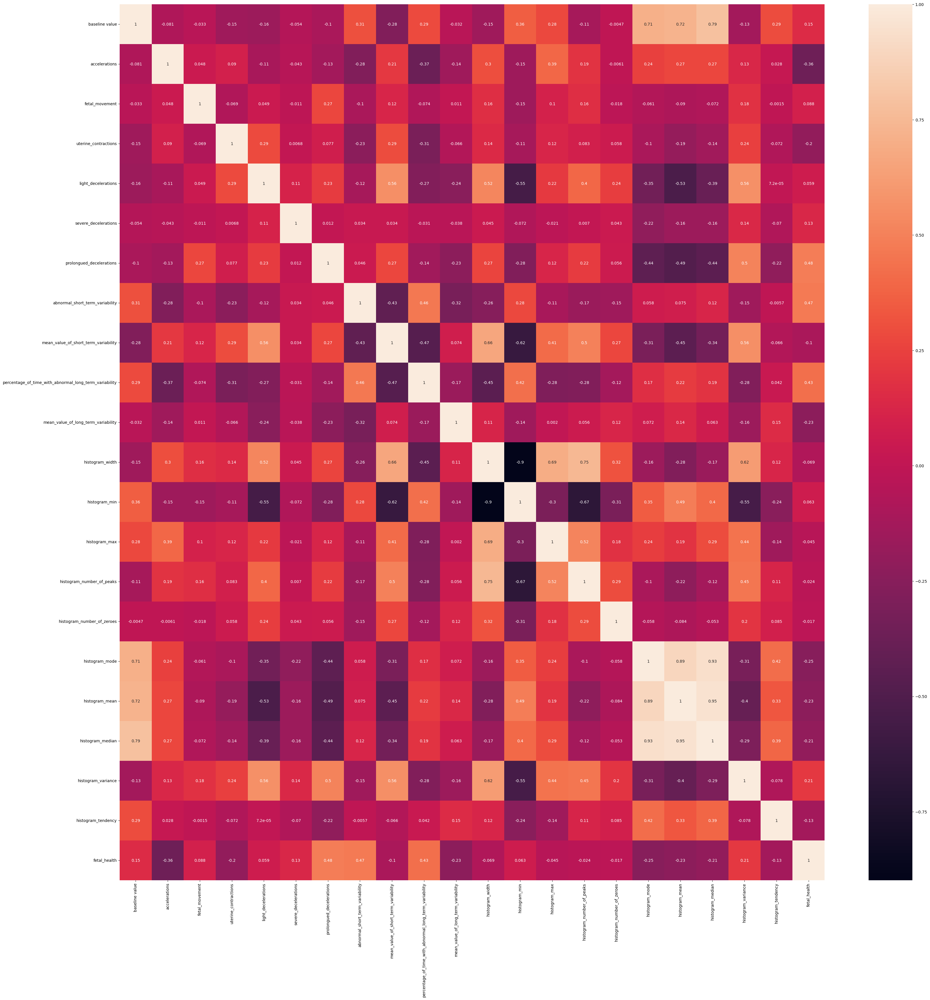

In [21]:
plt.figure(figsize=(40,40))
sns.heatmap(fhc_dataset.corr(),annot=True)

The goal is to identify the features to use in the EDA and isolate the features that will be most helpful in constructing a predictive model. The fetal_health is being used as the dependent variable to be predicted based on the other features.

We chose fetal_health as our dependent/response variable or y variable.

In [22]:
fhc_dataset.fetal_health.value_counts()

1.0    1655
2.0     295
3.0     176
Name: fetal_health, dtype: int64

The 3.0 or pathological type (176) is the least among the three types of fetal_health outcome compared to the 1.0 or normal (1655). This shows that the chosen response variable which is the fetal_health is unbalanced. This is to be considered during our data analysis and would affect the evaluation of any model's performance.

In [23]:
fhc_dataset = fhc_dataset.rename(columns={"baseline value":
                             "baseline_value"}) # make name pythonic

The following will show the correlations of the different features of fhc_dataset based on **correlations between -1.0 and -0.5 or 0.5 and 1.0**. The last part will show all the features that have correlation with each other.

In [24]:
# Define the cutoff value.  We want to keep only correlations greater (+correlations) or less (-correlations)
# then the cutoff.   E.G.  correlations > 0.5 OR correlations < -0.5
# Note: cutoff = 0.0 would return everything in the correlation dataframe.
cutoff = 0.5

# Find all the correlations that match the criteria (above), creating a dataframe of True (1) or False (0)
# True (0) values meet the criteria, False (1) do not meet the criteria.
fhc_corr=(abs(fhc_dataset.corr())>cutoff)

# element-wise, multiply the prior result with the correlation dataframe to clear out the unwnated correlations
fhc_corr=fhc_corr*fhc_dataset.corr()

# replace -0.0 with 0.0 to clean up the final dataframe
fhc_corr=fhc_corr.replace(to_replace=-0.0,value=0.0)

# Replace all 0.0 correlations with NAN, then count the number of remaining correlations in each column.
# Sum up these counts and subtract the number of attributes, given an attribute is always perfectly correlated
# with itself.  Finially divide by 2, since the correlation matrix is symmetric over the diagonal, removing the
# duplicated values from remaining from the earlier filtering.
count=((fhc_corr.replace(to_replace=0.0,value=np.nan)).count().sum()-fhc_corr.shape[0])/2

print('The number of matching correlations is: '+str(count))

The number of matching correlations is: 23.0


In [25]:
# Print the resulting dataframe "heatmap" showing only the correlations of interest
fhc_corr.style.background_gradient(cmap ='coolwarm')

,baseline_value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,mean_value_of_long_term_variability,histogram_width,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
baseline_value,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.708993,0.723121,0.789246,0.000000,0.000000,0.000000
accelerations,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
fetal_movement,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
uterine_contractions,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
light_decelerations,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.562170,0.000000,0.000000,0.520467,-0.553534,0.000000,0.000000,0.000000,0.000000,-0.527354,0.000000,0.564289,0.000000,0.000000
severe_decelerations,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
prolongued_decelerations,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.503301,0.000000,0.000000
abnormal_short_term_variability,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
mean_value_of_short_term_variability,0.000000,0.000000,0.000000,0.000000,0.562170,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.660847,-0.622569,0.000000,0.501430,0.000000,0.000000,0.000000,0.000000,0.555852,0.000000,0.000000
percentage_of_time_with_abnormal_long_term_variability,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [26]:
print("Correlations between -1.0 and -"+str(cutoff)+" or "+str(cutoff)+" and 1.0:")

# assemble a dataframe showing the list of correlations and the correlation coeffecient.  Also compile a list of
# the unique features
cols=fhc_corr.columns
items=set() # set of the features in the correlations of interest.
fhc_corr_list = pd.DataFrame({'Attr1' : [], 'Attr2' : [], 'Corr' : []})
for i in range(len(cols)):
    for j in range(i,len(cols)):
        if (fhc_corr.loc[cols[i]][cols[j]] != 0 and (cols[i] != cols[j])):
            fhc_corr_list.loc[len(fhc_corr_list.index)] = [cols[i], cols[j], fhc_corr.loc[cols[i]][cols[j]]] 
            items.add(cols[i])
            items.add(cols[j])

# print the list, sorted by 'Corr' (correlation) in descending order.
fhc_corr_list.sort_values(['Corr'], ascending=False)

Correlations between -1.0 and -0.5 or 0.5 and 1.0:


,Attr1,Attr2,Corr
22,histogram_mean,histogram_median,0.948251
21,histogram_mode,histogram_median,0.933399
20,histogram_mode,histogram_mean,0.893412
2,baseline_value,histogram_median,0.789246
15,histogram_width,histogram_number_of_peaks,0.747071
1,baseline_value,histogram_mean,0.723121
0,baseline_value,histogram_mode,0.708993
14,histogram_width,histogram_max,0.690769
9,mean_value_of_short_term_variability,histogram_width,0.660847
16,histogram_width,histogram_variance,0.615884


In [27]:
# Print the sorted list of features
k=0
for item in sorted(items):
    k += 1
    print(str(k)+') '+item)
    #print(item)

1) baseline_value
2) histogram_max
3) histogram_mean
4) histogram_median
5) histogram_min
6) histogram_mode
7) histogram_number_of_peaks
8) histogram_variance
9) histogram_width
10) light_decelerations
11) mean_value_of_short_term_variability
12) prolongued_decelerations


In [28]:
from patsy import dmatrices
from statsmodels.stats.outliers_influence import variance_inflation_factor

#find design matrix for regression model using 'rating' as response variable 
y, X = dmatrices('fetal_health ~ baseline_value+histogram_max+histogram_mean+histogram_median+histogram_min+histogram_mode+histogram_number_of_peaks+histogram_variance+histogram_width+light_decelerations+mean_value_of_short_term_variability+prolongued_decelerations', data=fhc_dataset, return_type='dataframe')

#create DataFrame to hold VIF values
vif_df = pd.DataFrame()
vif_df['variable'] = X.columns 

#calculate VIF for each predictor variable 
vif_df['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

#view VIF for each predictor variable 
print(vif_df)

                                variable         VIF
0                              Intercept  243.772663
1                         baseline_value    4.239164
2                          histogram_max         inf
3                         histogram_mean   16.031535
4                       histogram_median   22.779114
5                          histogram_min         inf
6                         histogram_mode    8.523526
7              histogram_number_of_peaks    2.291375
8                     histogram_variance    2.478102
9                        histogram_width         inf
10                   light_decelerations    2.782321
11  mean_value_of_short_term_variability    2.250881
12              prolongued_decelerations    2.289306


C:\Users\charr\anaconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:198: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


The above are the features that have correlations with each other. There is a high possiblity of collinearity between the features.

The following is another way of showing the correlation of the dataset's features with the dependent/response variable.

In [29]:
num_to_fetal_state = {1: "normal", 2: "suspect", 3: "pathological"}
#print(num_fetal_col)
num_classes = len(num_to_fetal_state)
print(num_classes)

3


In [30]:
df_corr = fhc_dataset.corr().fetal_health[:-1]
print(df_corr)

baseline_value                                            0.148151
accelerations                                            -0.364066
fetal_movement                                            0.088010
uterine_contractions                                     -0.204894
light_decelerations                                       0.058870
severe_decelerations                                      0.131934
prolongued_decelerations                                  0.484859
abnormal_short_term_variability                           0.471191
mean_value_of_short_term_variability                     -0.103382
percentage_of_time_with_abnormal_long_term_variability    0.426146
mean_value_of_long_term_variability                      -0.226797
histogram_width                                          -0.068789
histogram_min                                             0.063175
histogram_max                                            -0.045265
histogram_number_of_peaks                                -0.02

The top three that have the strongest correlation with fetal_health are:

- prolongued_decelerations
- abnormal_short_term_variability
- percentage_of_time_with_abnormal_long_term_variability

In [31]:
indices = df_corr.abs().sort_values(ascending=False).index[:6]
indices = indices.append(pd.Index(["fetal_health"]))
indices

Index(['prolongued_decelerations', 'abnormal_short_term_variability',
       'percentage_of_time_with_abnormal_long_term_variability',
       'accelerations', 'histogram_mode', 'histogram_mean', 'fetal_health'],
      dtype='object')

Replacing the numbers in fetal_health with their labels: 
- 1.0 = normal
- 2.0 = suspect
- 3.0 = pathological

In [32]:
fhc_dataset

,baseline_value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.000,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.000,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.000,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2121,140.0,0.000,0.000,0.007,0.000,0.0,0.0,79.0,0.2,25.0,...,137.0,177.0,4.0,0.0,153.0,150.0,152.0,2.0,0.0,2.0
2122,140.0,0.001,0.000,0.007,0.000,0.0,0.0,78.0,0.4,22.0,...,103.0,169.0,6.0,0.0,152.0,148.0,151.0,3.0,1.0,2.0
2123,140.0,0.001,0.000,0.007,0.000,0.0,0.0,79.0,0.4,20.0,...,103.0,170.0,5.0,0.0,153.0,148.0,152.0,4.0,1.0,2.0
2124,140.0,0.001,0.000,0.006,0.000,0.0,0.0,78.0,0.4,27.0,...,103.0,169.0,6.0,0.0,152.0,147.0,151.0,4.0,1.0,2.0


In [33]:
fhc_dataset.fetal_health.astype(object, copy=False)
fhc_dataset.fetal_health.replace(num_to_fetal_state, inplace=True)
fhc_dataset.head().T

,0,1,2,3,4
baseline_value,120.0,132.0,133.0,134.0,132.0
accelerations,0.0,0.006,0.003,0.003,0.007
fetal_movement,0.0,0.0,0.0,0.0,0.0
uterine_contractions,0.0,0.006,0.008,0.008,0.008
light_decelerations,0.0,0.003,0.003,0.003,0.0
severe_decelerations,0.0,0.0,0.0,0.0,0.0
prolongued_decelerations,0.0,0.0,0.0,0.0,0.0
abnormal_short_term_variability,73.0,17.0,16.0,16.0,16.0
mean_value_of_short_term_variability,0.5,2.1,2.1,2.4,2.4
percentage_of_time_with_abnormal_long_term_variability,43.0,0.0,0.0,0.0,0.0


Visualization using pairplots of the top six correlated features with fetal_health, as determined above.

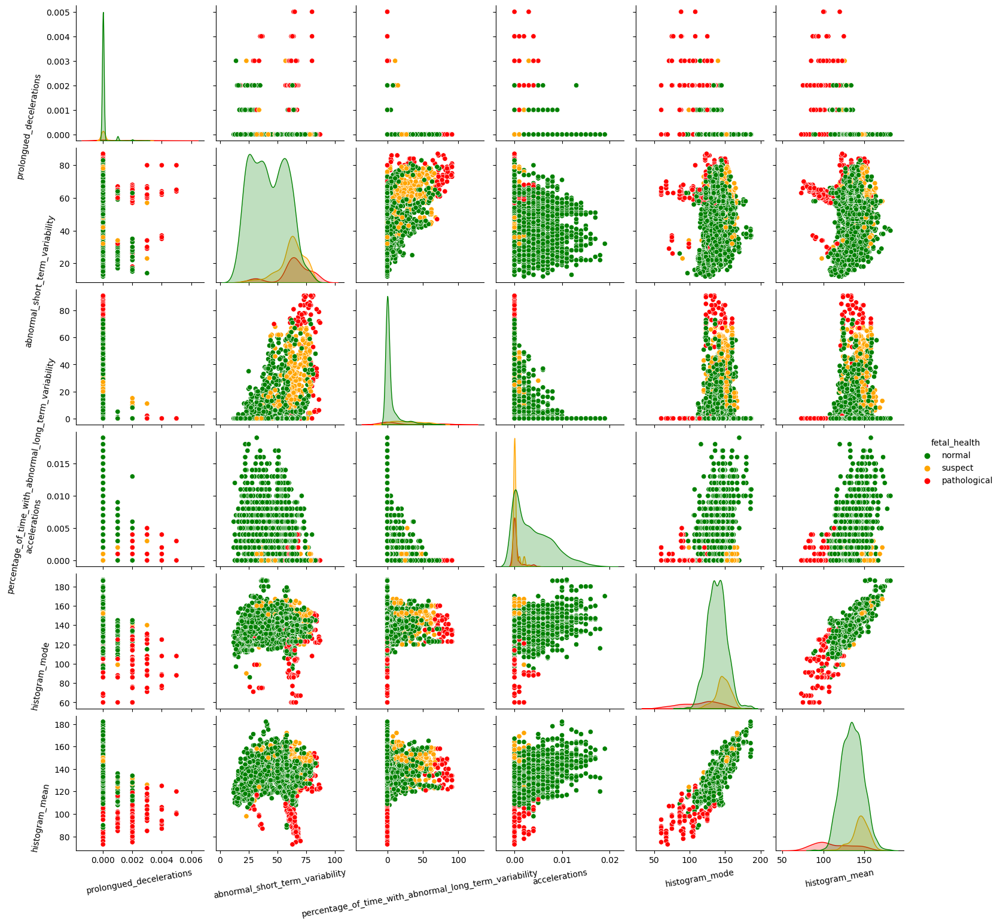

In [34]:
g = sns.pairplot(
    fhc_dataset[indices],
    hue="fetal_health",
    hue_order=num_to_fetal_state.values(),
    palette=["green", "orange", "red"]
)

for ax in g.axes.flatten():
    ax.set_xlabel(ax.get_xlabel(), rotation = 10)
    ax.set_ylabel(ax.get_ylabel(), rotation = 80)
    ax.yaxis.get_label().set_horizontalalignment('right')

This graph will show some of the features in pairs and show some insights into the relationships between different features and fetal health.

We see that all of the values are shifted towards the low end especially for the pathological data. The normal data shifted toward more toward the higher end with the suspect data somewhere in the middle. We do see a strong correlation between histogram_mean and histogram_mode. 

In addition, we can calculate the feature that is most correlated with each individual feature.

In [35]:
df_corr = fhc_dataset.corr()
for i in range(len(df_corr)):
    df_corr.iloc[i, i] = 0.0
    
corr_idx = df_corr.abs().idxmax()
correlations = []
for index, column in zip(corr_idx.index, corr_idx):
    correlations += [df_corr[index][column]]
    
df_corr = pd.DataFrame(corr_idx)
df_corr.columns = ["Most correlated feature"]
df_corr["correlation"] = correlations
df_corr.iloc[df_corr["correlation"].abs().argsort()[::-1]]


,Most correlated feature,correlation
histogram_median,histogram_mean,0.948251
histogram_mean,histogram_median,0.948251
histogram_mode,histogram_median,0.933399
histogram_min,histogram_width,-0.898519
histogram_width,histogram_min,-0.898519
baseline_value,histogram_median,0.789246
histogram_number_of_peaks,histogram_width,0.747071
histogram_max,histogram_width,0.690769
mean_value_of_short_term_variability,histogram_width,0.660847
histogram_variance,histogram_width,0.615884


This shows that there is a strong correlation between histogram_mean, histogram_median and histogram_mode. Same seen with histogram_min and histogram_width.

**Visualization of the correlation of the dataset by fetal_health followed by a Bar Plot.**

In [36]:
fhc_dataset2 = pd.get_dummies(fhc_dataset, "fetal_health")
fhc_dataset2 = fhc_dataset2.astype(float)
fhc_dataset2.iloc[:, -num_classes:].head()

df_corr = (
    fhc_dataset2.corr().iloc[:-num_classes, -num_classes:]
        .sort_values("fetal_health_normal")
)
df_corr

,fetal_health_normal,fetal_health_pathological,fetal_health_suspect
abnormal_short_term_variability,-0.493391,0.306735,0.348213
percentage_of_time_with_abnormal_long_term_variability,-0.489400,0.212343,0.418659
prolongued_decelerations,-0.340554,0.567540,-0.043281
baseline_value,-0.251875,-0.049357,0.341922
histogram_min,-0.158171,-0.097555,0.267773
severe_decelerations,-0.087967,0.161516,-0.023070
histogram_variance,-0.085948,0.331060,-0.160642
fetal_movement,-0.060974,0.104288,-0.009881
histogram_number_of_zeroes,0.031163,0.009780,-0.045231
light_decelerations,0.032889,0.180793,-0.183622


<AxesSubplot:>

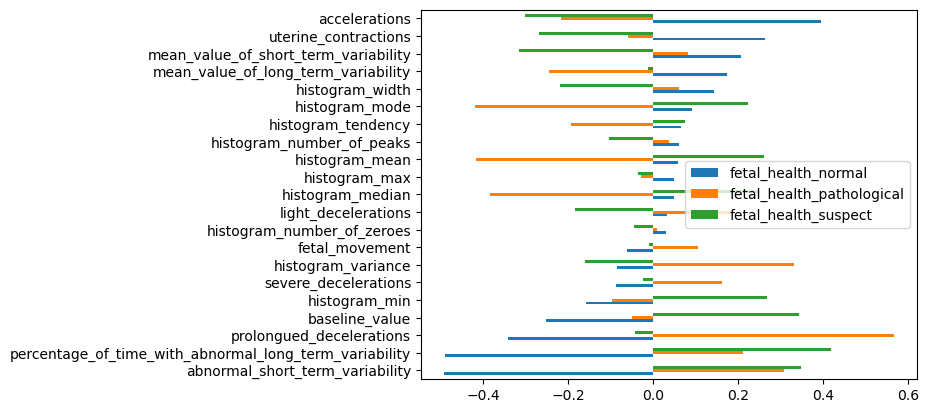

In [37]:
df_corr.plot(kind="barh")

The correlations of the features with normal class and others tends to be inversely proportional. 

It is useful to visualize the distribution of the data using a Boxplot:
This will compare each of the features divided by the three different fetal_health types **('normal', 'suspect', 'pathological')**

C:\Users\charr\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\tools.py:223: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(**fig_kw)


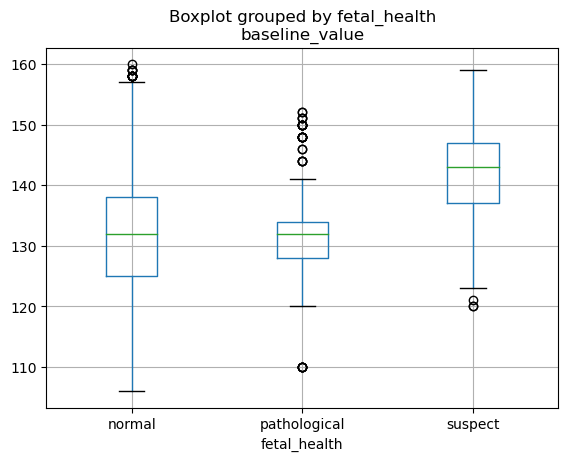

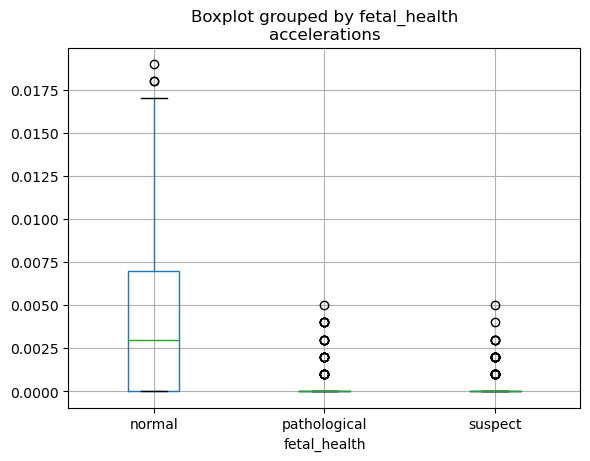

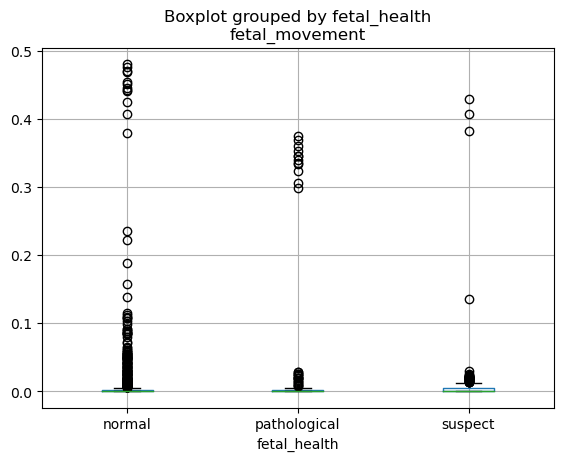

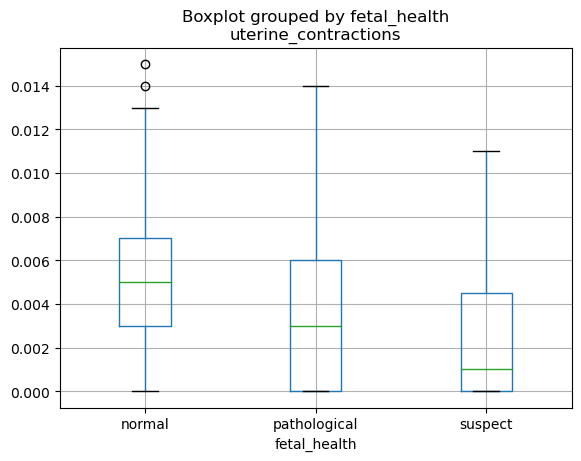

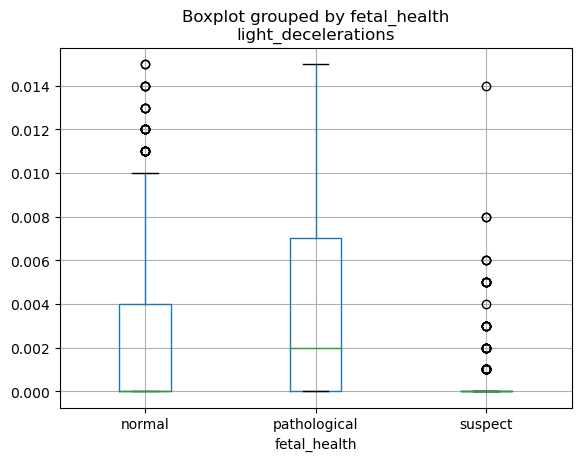

...

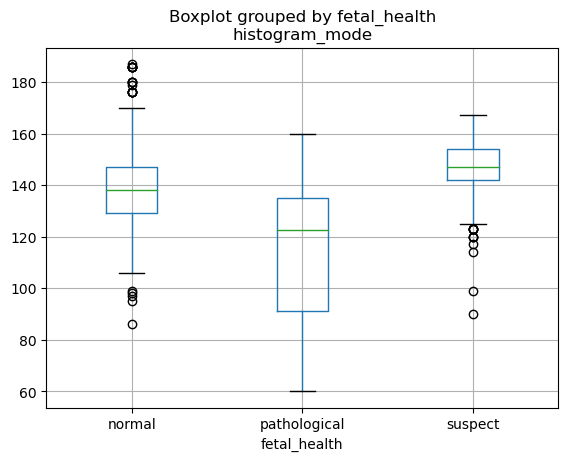

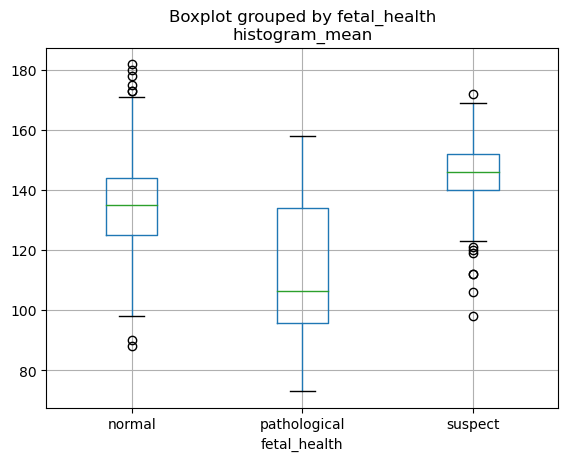

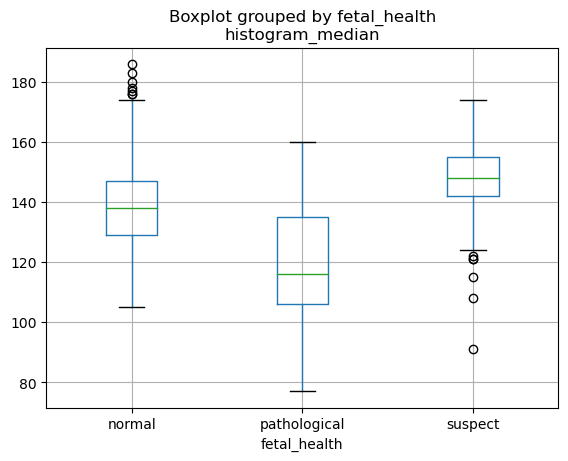

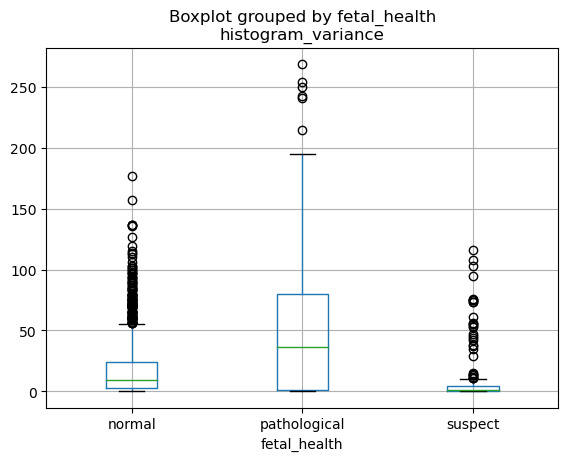

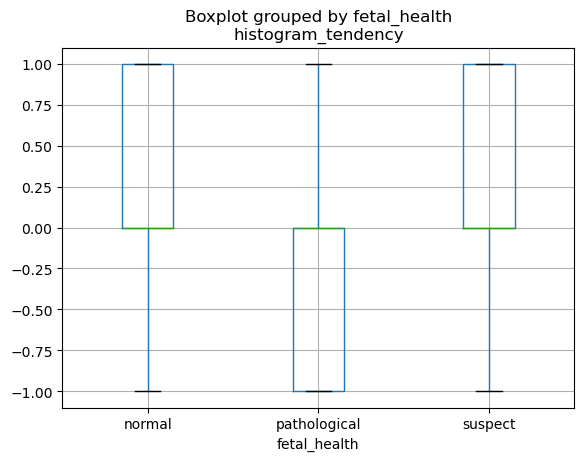

In [38]:
for i in fhc_dataset.columns:
    if i != 'fetal_health':
        fhc_dataset.boxplot(i, by='fetal_health')

From the boxplot above, we can see that the distribution of the feature values against fetal_health classes are generally different.  

**The best statistical tests** to compare more than two groups is One-way ANOVA	or Kruskal-Wallis test. We chose the **One-way ANOVA**. One-way analysis of variance (ANOVA) is the appropriate method instead of the t test. As the ANOVA is based on the same assumptions as the t test.


In [39]:
for i in fhc_dataset.columns:
    if i != 'fetal_health':
        print("----------------------------------------------------------")
        print(i+":")
        model = ols(i+' ~ fetal_health', data=fhc_dataset).fit()
        aov_table = sm.stats.anova_lm(model, typ=2)
        display(aov_table)

----------------------------------------------------------
baseline_value:


,sum_sq,df,F,PR(>F)
fetal_health,24072.758323,2.0,140.621076,4.457098e-58
Residual,181716.950049,2123.0,NaN,NaN


----------------------------------------------------------
accelerations:


,sum_sq,df,F,PR(>F)
fetal_health,0.004950,2.0,196.027523,7.520612e-79
Residual,0.026804,2123.0,NaN,NaN


----------------------------------------------------------
fetal_movement:


,sum_sq,df,F,PR(>F)
fetal_health,0.050364,2.0,11.679797,0.000009
Residual,4.577251,2123.0,NaN,NaN


----------------------------------------------------------
uterine_contractions:


,sum_sq,df,F,PR(>F)
fetal_health,0.001496,2.0,93.715743,9.935711e-40
Residual,0.016947,2123.0,NaN,NaN


----------------------------------------------------------
light_decelerations:


,sum_sq,df,F,PR(>F)
fetal_health,0.001103,2.0,66.864754,6.901148e-29
Residual,0.017518,2123.0,NaN,NaN


----------------------------------------------------------
severe_decelerations:


,sum_sq,df,F,PR(>F)
fetal_health,1.821017e-07,2.0,28.448156,6.423596e-13
Residual,6.794850e-06,2123.0,NaN,NaN


----------------------------------------------------------
prolongued_decelerations:


,sum_sq,df,F,PR(>F)
fetal_health,0.000239,2.0,505.853206,2.210238e-180
Residual,0.000501,2123.0,NaN,NaN


----------------------------------------------------------
abnormal_short_term_variability:


,sum_sq,df,F,PR(>F)
fetal_health,153677.100677,2.0,343.820419,4.472368e-130
Residual,474457.691891,2123.0,NaN,NaN


----------------------------------------------------------
mean_value_of_short_term_variability:


,sum_sq,df,F,PR(>F)
fetal_health,168.221443,2.0,119.882006,4.695912e-50
Residual,1489.523472,2123.0,NaN,NaN


----------------------------------------------------------
percentage_of_time_with_abnormal_long_term_variability:


,sum_sq,df,F,PR(>F)
fetal_health,176471.736672,2.0,345.156385,1.631148e-130
Residual,542724.274617,2123.0,NaN,NaN


----------------------------------------------------------
mean_value_of_long_term_variability:


,sum_sq,df,F,PR(>F)
fetal_health,4174.078399,2.0,70.174093,3.082054e-30
Residual,63139.886253,2123.0,NaN,NaN


----------------------------------------------------------
histogram_width:


,sum_sq,df,F,PR(>F)
fetal_health,1.590987e+05,2.0,55.088241,4.738119e-24
Residual,3.065687e+06,2123.0,NaN,NaN


----------------------------------------------------------
histogram_min:


,sum_sq,df,F,PR(>F)
fetal_health,1.411660e+05,2.0,87.340503,3.534810e-37
Residual,1.715672e+06,2123.0,NaN,NaN


----------------------------------------------------------
histogram_max:


,sum_sq,df,F,PR(>F)
fetal_health,1585.193529,2.0,2.464923,0.085259
Residual,682651.434881,2123.0,NaN,NaN


----------------------------------------------------------
histogram_number_of_peaks:


,sum_sq,df,F,PR(>F)
fetal_health,208.418582,2.0,12.104834,0.000006
Residual,18276.691954,2123.0,NaN,NaN


----------------------------------------------------------
histogram_number_of_zeroes:


,sum_sq,df,F,PR(>F)
fetal_health,2.187408,2.0,2.196373,0.111458
Residual,1057.167248,2123.0,NaN,NaN


----------------------------------------------------------
histogram_mode:


,sum_sq,df,F,PR(>F)
fetal_health,117372.515517,2.0,275.117696,5.720429e-107
Residual,452864.090786,2123.0,NaN,NaN


----------------------------------------------------------
histogram_mean:


,sum_sq,df,F,PR(>F)
fetal_health,113151.960435,2.0,297.625497,1.145660e-114
Residual,403563.563554,2123.0,NaN,NaN


----------------------------------------------------------
histogram_median:


,sum_sq,df,F,PR(>F)
fetal_health,84436.764865,2.0,248.772237,8.606065e-98
Residual,360287.895530,2123.0,NaN,NaN


----------------------------------------------------------
histogram_variance:


,sum_sq,df,F,PR(>F)
fetal_health,2.219566e+05,2.0,150.796849,5.796289e-62
Residual,1.562413e+06,2123.0,NaN,NaN


----------------------------------------------------------
histogram_tendency:


,sum_sq,df,F,PR(>F)
fetal_health,31.929973,2.0,44.542294,1.123007e-19
Residual,760.932210,2123.0,NaN,NaN


**HYPOTHESIS TESTING:**
 
H0: Are the three fetal_health classes equal in this feature?
 
H1: The three fetal_health classes are not equal in this feature?
 
if p < 0.05, this means we **REJECT** the NULL hypothesis. 
This tells us the feature is not comparable between the three classes and may have predictive ability.

if p >= 0.05, this means we **DO NOT REJECT** the NULL hypothesis.
This tells us the feature is comparable between the three classes and may have no predictive ability.
 

**RESULTS:**

The only features that have a p-value >= 0.05 are histogram_number_of_zeroes and histogram_max. These features may have no predictive ability. All of the other features may have predictive ability.

**Saving the cleaned data into a csv file.**

In [40]:
fhc_dataset.to_csv('archive/cleanedDataEDA.csv', index=False)

### SUMMARY

The following tasks were performed:

 We start our EDA analysis by assessing the quality of the data. We do this to understand what information is in the data and make sure what the data stands for and what is missing.

We concluded from the data wrangling that we have no missing data and have a tidy data.

We generated a Pandas profiling report which shows us correlation tables, heatmaps which gives us an overview that some of the features might have strong correlation to each other. 

The fetal_health column showed 1 to 3 which represents the three different classes which are 1 for normal, 2 for suspect and 3 for pathological which becomes the dependent variable to be predicted based on the other features. From it's value counts, looks like the normal has the most of the data samples.

Next, we looked at correlation of the different features by focusing on values between -1.0 and -0.5 or 0.5 and 1.0. Top three listed baseline_value, histogram_max and histogram_mean.

The variance_inflation_factor (VIF) was anlayze to check for collinearity between the different features and showed that there is a high possiblity of collinearity between the features.

Other visualization like the boxplot and heatmap were created and only more questions come up to see if the variables would show some more interaction. This leads to the need for further exploration.

Looked at the correlation of the different features against fetal_health and the top three that have the strongest correlation with fetal_health are:
- prolongued_decelerations
- abnormal_short_term_variability
- percentage_of_time_with_abnormal_long_term_variability

For visualization, the pairplots to showed insights into the relationships between different features and fetal health. We see that all of the values are shifted towards the low end especially for the pathological data. The normal data shifted toward more toward the higher end with the suspect data somewhere in the middle. We do see a strong correlation between histogram_mean and histogram_mode. 

The best statistical tests to compare more than two groups is One-way ANOVA or Kruskal-Wallis test. We chose the One-way ANOVA. One-way analysis of variance (ANOVA) is the appropriate method instead of the t test. As the ANOVA is based on the same assumptions as the t test.

The only features that have a p-value >= 0.05 are histogram_number_of_zeroes and histogram_max. These features may have no predictive ability. All of the other features may have predictive ability.

Lastly, we saved the cleaned data into a csv file for future use.